# Used Car Prices CarGurus lightGBM GPU
# Weights & Biases Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

In [ ]:
# In terminal
sudo apt update && sudo apt upgrade

sudo apt-get -y install cmake

sudo apt-get install -y -qq libboost-all-dev libboost-system-dev libboost-filesystem-dev

sudo apt-get install --no-install-recommends nvidia-opencl-dev opencl-headers

sudo apt install glibc-source -y

In [ ]:
%cd /notebooks

In [ ]:
# Clone repo
!git clone --recursive https://github.com/microsoft/LightGBM

Cloning into 'LightGBM'...
remote: Enumerating objects: 28765, done.
remote: Counting objects: 100% (3846/3846), done.
remote: Compressing objects: 100% (451/451), done.
remote: Total 28765 (delta 3575), reused 3485 (delta 3386), pack-reused 24919
Receiving objects: 100% (28765/28765), 20.18 MiB | 2.37 MiB/s, done.
Resolving deltas: 100% (21307/21307), done.
Updating files: 100% (535/535), done.
Submodule 'include/boost/compute' (https://github.com/boostorg/compute) registered for path 'external_libs/compute'
Submodule 'eigen' (https://gitlab.com/libeigen/eigen.git) registered for path 'external_libs/eigen'
Submodule 'external_libs/fast_double_parser' (https://github.com/lemire/fast_double_parser.git) registered for path 'external_libs/fast_double_parser'
Submodule 'external_libs/fmt' (https://github.com/fmtlib/fmt.git) registered for path 'external_libs/fmt'
Cloning into '/notebooks/LightGBM/external_libs/compute'...
remote: Enumerating objects: 21733, done.        
remote: Counting o

In [ ]:
# Set up build
%cd /notebooks/LightGBM

!sudo mkdir build

!sudo mkdir -p /etc/OpenCL/vendors && echo "libnvidia-opencl.so.1" > /etc/OpenCL/vendors/nvidia.icd

/notebooks/LightGBM


In [ ]:
%cd /notebooks/LightGBM/build

/notebooks/LightGBM/build


In [ ]:
# Use cmake to build
!sudo cmake -DUSE_GPU=1 -DOpenCL_LIBRARY=/usr/local/cuda/lib64/libOpenCL.so -DOpenCL_INCLUDE_DIR=/usr/local/cuda/include/ ..

-- OpenCL include directory: /usr/local/cuda/include
-- Using _mm_prefetch
-- Using _mm_malloc
-- Configuring done
-- Generating done
-- Build files have been written to: /notebooks/LightGBM/build


In [ ]:
# Build
!make -j4

[  1%] Built target lightgbm_capi_objs
[ 92%] Built target lightgbm_objs
[ 94%] Built target _lightgbm
[100%] Built target lightgbm


In [ ]:
# Install dependencies
!sudo apt-get -y install python3-pip
!sudo -H pip install setuptools joblib wandb optuna datetime plotly eli5 shap -U

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  python-pip-whl python3-setuptools python3-wheel
Suggested packages:
  python-setuptools-doc
The following NEW packages will be installed:
  python-pip-whl python3-pip python3-setuptools python3-wheel
0 upgraded, 4 newly installed, 0 to remove and 0 not upgraded.
Need to get 2389 kB of archives.
After this operation, 4932 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python-pip-whl all 20.0.2-5ubuntu1.6 [1805 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal/main amd64 python3-setuptools all 45.2.0-1 [330 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/universe amd64 python3-wheel all 0.34.2-1 [23.8 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python3-pip all 20.0.2-5ubuntu1.6 [231 kB]
Fetched 2389 kB in 1s (2944 kB/s)   
Selecting previously unsele

In [ ]:
# Install LightGBM GPU
%cd /notebooks/LightGBM/python-package/
!python setup.py install --gpu --opencl-include-dir=/usr/local/cuda/include/

/notebooks/LightGBM/python-package
INFO:root:running install
/usr/local/lib/python3.9/dist-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
INFO:LightGBM:Starting to compile the library.
INFO:LightGBM:Starting to compile with CMake.
INFO:root:running build
INFO:root:running build_py
INFO:root:running egg_info
INFO:root:writing lightgbm.egg-info/PKG-INFO
INFO:root:writing dependency_links to lightgbm.egg-info/dependency_links.txt
INFO:root:writing requirements to lightgbm.egg-info/requires.txt
INFO:root:writing top-level names to lightgbm.egg-info/top_level.txt
INFO:root:reading manifest file 'lightgbm.egg-info/SOURCES.txt'
INFO:root:reading manifest template 'MANIFEST.in'
INFO:root:adding license file 'LICENSE'
INFO:root:writing manifest file 'lightgbm.egg-info/SOURCES.txt'
INFO:root:copying lightgbm/VERSION.txt -> build/lib/lightgbm
INFO:root:running install_lib


In [ ]:
# Install rapids utils
!pip install cudf-cu11 dask-cudf-cu11 --extra-index-url=https://pypi.ngc.nvidia.com
!pip install cuml-cu11 --extra-index-url=https://pypi.ngc.nvidia.com

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.8/442.8 MB 4.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 kB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 60.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.8/91.8 MB 16.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 441.3/441.3 kB 58.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 77.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 89.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.3/35.3 MB 40.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 94.7 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 100.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 89.9 M

# Quadro RTX 4000

In [ ]:
# Install/import dependencies
import os
import random
import warnings
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sat Jan 28 13:07:54 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 4000     Off  | 00000000:00:05.0 Off |                  N/A |
| 30%   26C    P8     1W / 125W |      3MiB /  8192MiB |      0%      Default |
|                               |    

In [ ]:
# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_lgbmGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(threads_per_worker=1, ip='', 
                           dashboard_address='8082') 
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

2023-01-28 13:07:56,875 - distributed.preloading - INFO - Creating preload: dask_cuda.initialize
2023-01-28 13:07:56,875 - distributed.preloading - INFO - Import preload module: dask_cuda.initialize
2023-01-28 13:07:57,249 - distributed.worker - WARNING - Mismatched versions found

+---------+---------------------------------------------+----------------+----------------+
| Package | Worker-a4f6a633-01aa-45b9-b711-4c7e948f65fa | Scheduler      | Workers        |
+---------+---------------------------------------------+----------------+----------------+
| python  | 3.9.16.final.0                              | 3.9.13.final.0 | 3.9.16.final.0 |
| tornado | 6.1                                         | 6.2            | 6.1            |
+---------+---------------------------------------------+----------------+----------------+


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.10.98:8082/status,
Dashboard: http://10.42.10.98:8082/status,Workers: 1
Total threads: 1,Total memory: 26.44 GiB
Status: running,Using processes: True
Comm: tcp://10.42.10.98:33121,Workers: 1
Dashboard: http://10.42.10.98:8082/status,Total threads: 1
Started: Just now,Total memory: 26.44 GiB
Comm: tcp://10.42.10.98:39751,Total threads: 1
Dashboard: http://10.42.10.98:35889/status,Memory: 26.44 GiB
Nanny: tcp://10.42.10.98:44325,


In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data 
trainDF = cudf.read_csv('usedCars_trainSet.csv')
testDF = cudf.read_csv('usedCars_testSet.csv')

# Define label and features
train_label = trainDF[['price']]
test_label = testDF[['price']]

train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

# Create dummy variables for categorical variables
train_features = cudf.get_dummies(train_features)
test_features = cudf.get_dummies(test_features)

In [ ]:
# Convert data type for modeling
train_features = train_features.astype('float32')
train_label = train_label.astype('int32')

test_features = test_features.astype('float32')
test_label = test_label.astype('int32')

train_features = train_features.to_numpy()
train_label = train_label.to_numpy()
test_features = test_features.to_numpy()
test_label = test_label.to_numpy()

### 100 Trials Train/Test

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_RTX4000_trainTest_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_RTX4000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002, 
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(**params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-24 23:13:58.217568


Trial RMSE: 2711.776291614393


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.7905949344295


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2644.6174831704748


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2703.6977288103653


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2673.579357319386


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2671.673510664786


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2666.173368825137


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2642.1903618524516


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2667.9630613043864


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2669.1946919856305


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.788982415031


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.514479083454


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2653.9005569368433


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.106079914876


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.2616811581047


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.4244996599155


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.3325473773234


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2698.930400901275


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.751178750023


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.040668222842


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.3267591376816


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.6695793910867


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.2121939146646


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.5044240034717


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.927770514915


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.391166317229


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.1382950646253


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2661.388470628109


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.8911139550514


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2699.647500478594


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.5369814620653


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.2503513616953


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.7229389647605


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.777510175929


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.638191414443


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.614274059086


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.8741882204436


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.8565919367898


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.1153807257892


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.7592740586288


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.638912824935


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.636385536209


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.310111233586


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.150085300575


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.7349719865374


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.592458552054


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.5502010090213


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.7849769582344


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.404723436906


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.0470405170763


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.9053741695257


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.6276342102715


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.410204775023


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.501029202678


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.782828670987


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.3226655792337


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2699.350884421485


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.824769031536


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.908870467773


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.847572101305


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2661.050800207856


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.365975541106


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.6500995468796


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.001677847232


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.4405338501124


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.4276548879184


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.319657556959


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.29820326124


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.905655836049


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.3309078231646


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.09232463845


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.4138106845726


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.740108527216


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.7570186530916


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.4059061666776


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.651514512638


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.9075703239


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.8248773258574


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2659.725075016569


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.824771856644


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.966390707611


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.664067630653


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.1671168210373


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.022157513153


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.2952997608795


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.620162249182


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.4770354154


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.4407888572755


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.7689449067757


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.141807075636


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.395722325043


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.3141062624504


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.804585946444


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.2820855213995


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.3523677906232


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.7506707603875


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.15215946717


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.0824969030996


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.4874779520387


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.0093008813633


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-24 23:13:58.217568
End Time             2023-01-25 00:33:30.415896
1:19:32


Number of finished trials: 100
Best trial: {'n_estimators': 931, 'learning_rate': 0.00799769744700877, 'num_leaves': 353, 'bagging_freq': 10, 'subsample': 0.9413800952691866, 'colsample_bytree': 0.8051036143532133, 'max_depth': 11, 'lambda_l1': 0.020053222619870723, 'lambda_l2': 0.0014498874046186669, 'min_child_samples': 545}
Lowest RMSE 2632.5044240034717


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
23         23  2632.504424 2023-01-24 23:31:14.970628   
21         21  2632.669579 2023-01-24 23:29:19.192956   
18         18  2632.751179 2023-01-24 23:27:07.368762   
83         83  2633.022158 2023-01-25 00:19:22.407942   
96         96  2633.152159 2023-01-25 00:30:17.822503   
..        ...          ...                        ...   
17         17  2698.930401 2023-01-24 23:26:31.935956   
56         56  2699.350884 2023-01-24 23:57:43.925401   
29         29  2699.647500 2023-01-24 23:35:55.031971   
3           3  2703.697729 2023-01-24 23:16:10.080048   
0           0  2711.776292 2023-01-24 23:13:58.219625   

            datetime_complete               duration  bagging_freq  \
23 2023-01-24 23:31:55.266887 0 days 00:00:40.296259            10   
21 2023-01-24 23:30:00.940593 0 days 00:00:41.747637            10   
18 2023-01-24 23:27:50.489645 0 days 00:00:43.120883            10   
83 2023-01-25 00:20:01.104982 0 day

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.html')
fig.show()

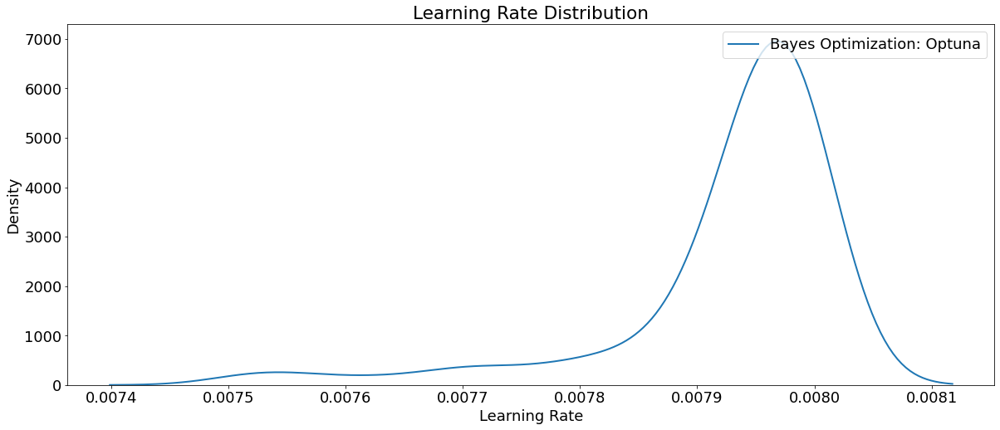

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

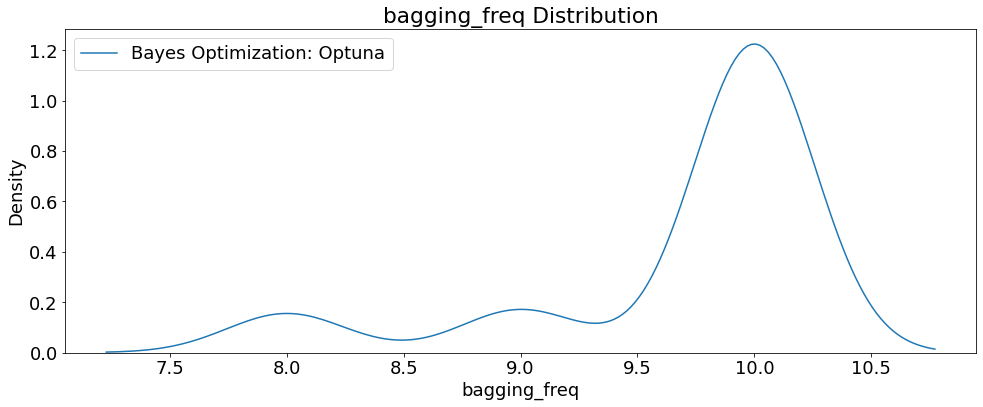

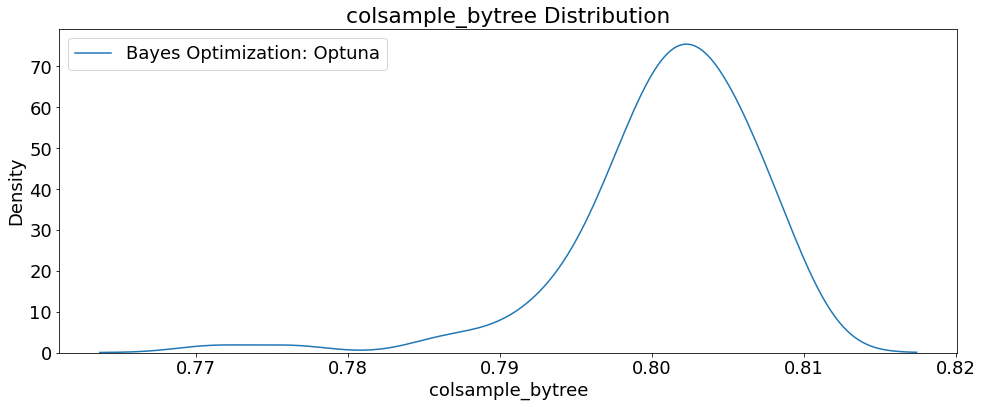

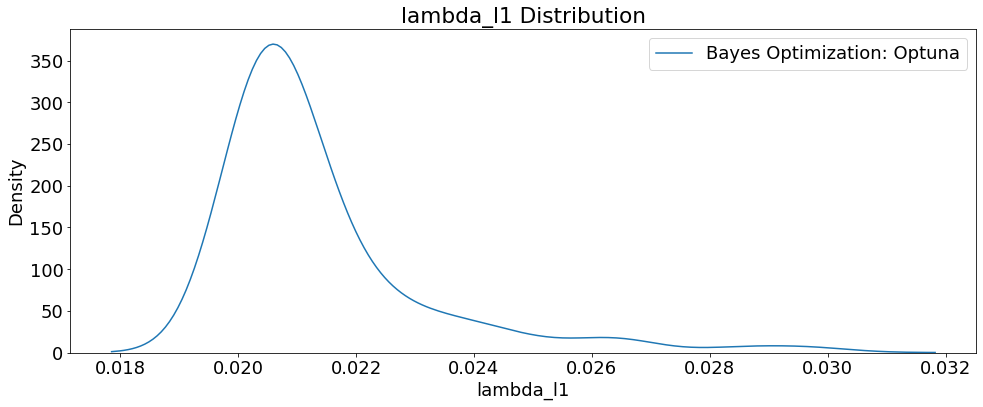

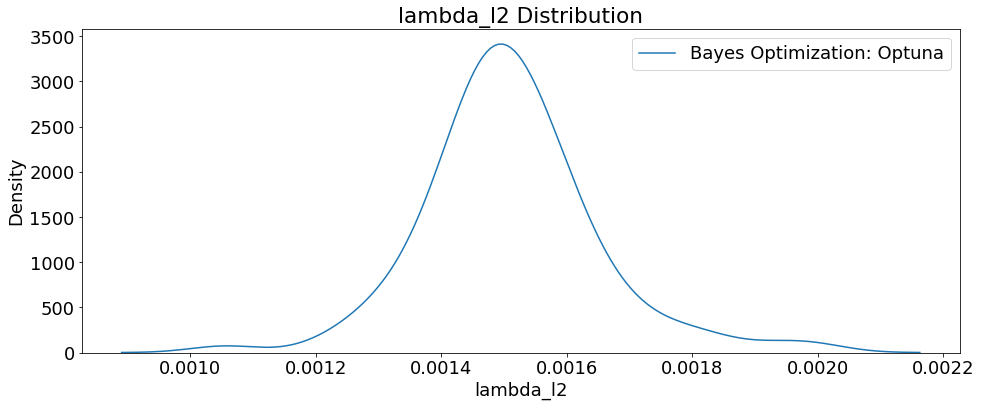

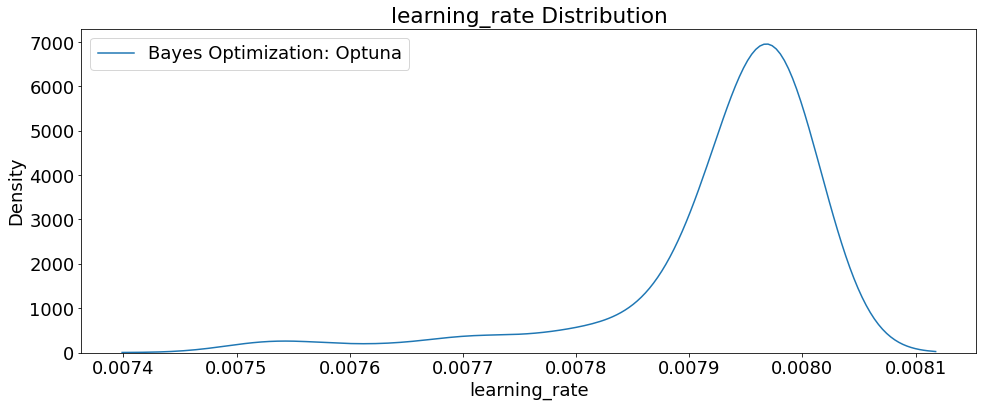

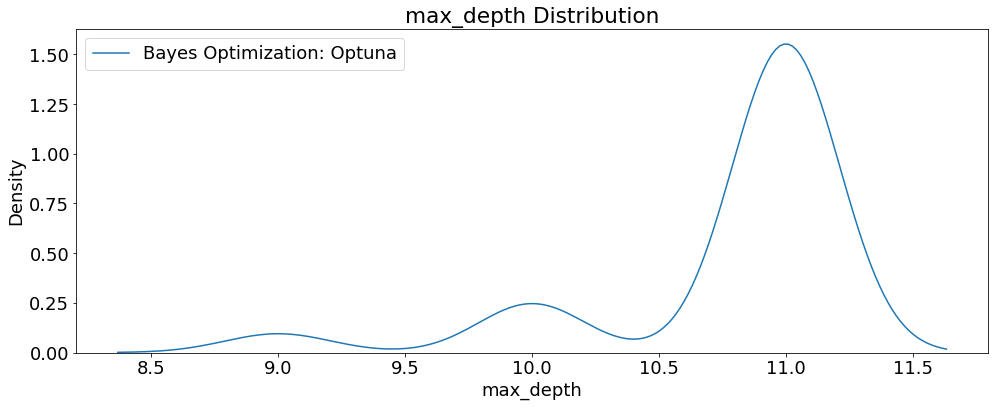

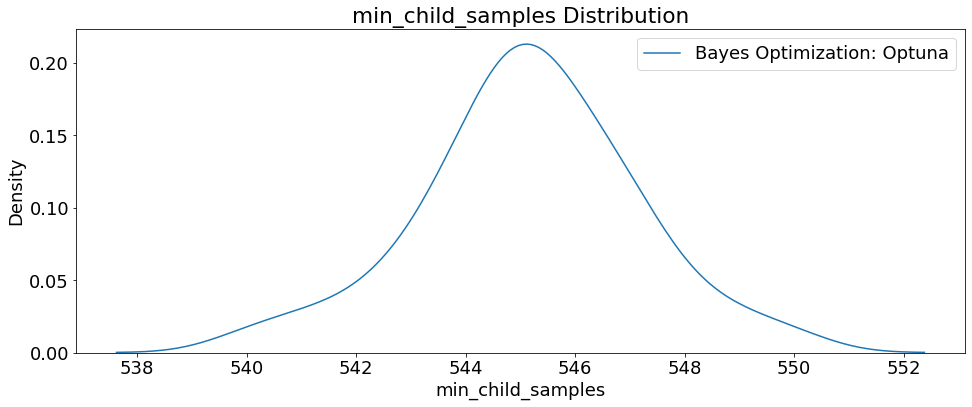

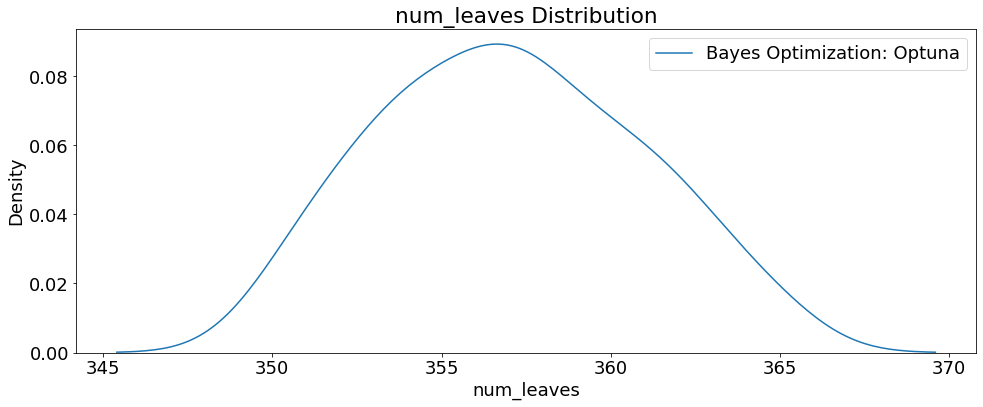

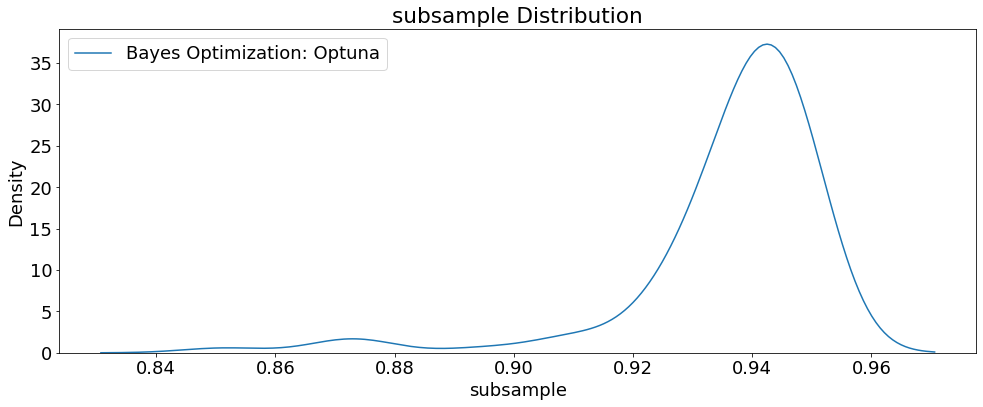

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

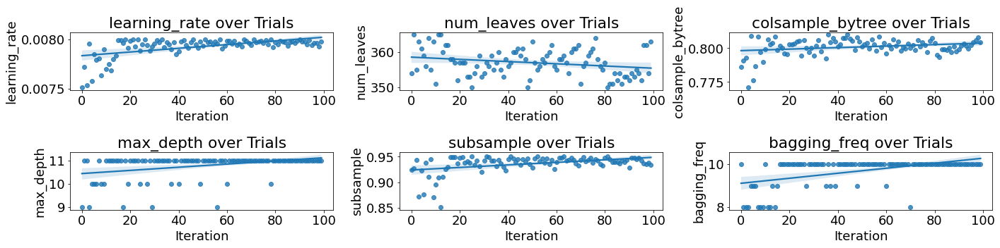

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

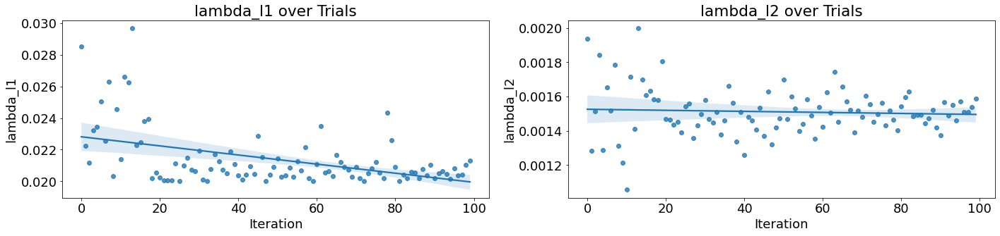

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_RTX4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 931,
 'learning_rate': 0.00799769744700877,
 'num_leaves': 353,
 'bagging_freq': 10,
 'subsample': 0.9413800952691866,
 'colsample_bytree': 0.8051036143532133,
 'max_depth': 11,
 'lambda_l1': 0.020053222619870723,
 'lambda_l2': 0.0014498874046186669,
 'min_child_samples': 545,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_RTX4000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_RTX4000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1941.556, test: 1963.631
MSE train: 6786741.830, test: 6930919.109
RMSE train: 2605.138, test: 2632.664
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6930919.10867 MSE on the test set.
This was achieved using these conditions:
iteration                                    23
rmse                                2632.504424
datetime_start       2023-01-24 23:31:14.970628
datetime_complete    2023-01-24 23:31:55.266887
duration                 0 days 00:00:40.296259
bagging_freq                                 10
colsample_bytree                       0.805104
lambda_l1                              0.020053
lambda_l2                               0.00145
learning_rate                          0.007998
max_depth                                    11
min_child_samples                           545
n_estimators                                931
num_leaves                                  353
subsample                               0.94138
state                                  COMPLETE
Name: 23, dtype: object


# Quadro RTX 5000

In [ ]:
# Install/import dependencies
import os
import random
import warnings
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sat Jan 28 04:09:10 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 5000     Off  | 00000000:00:05.0 Off |                  Off |
| 33%   33C    P8    13W / 230W |      3MiB / 16384MiB |      0%      Default |
|                               |    

### 100 Trials Train/Test

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_RTX5000_trainTest_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_RTX5000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002, 
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(**params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-26 02:22:05.030484


wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Trial RMSE: 2643.1801879748054


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2672.777490168611


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2649.2705126722667


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2709.5077840388976


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2705.1413330207856


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2644.9981539213622


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2702.912060578516


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2711.5070388209565


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.8081585882255


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2703.7803014939286


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2672.6788907127443


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2642.0866414674783


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.6371608889517


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2665.880593485756


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2646.011300252527


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.2765548172356


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2668.7356171498136


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2648.4303280072054


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2667.5803821409913


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.0998119316764


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2666.0766188474654


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2642.041582396708


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.5507615750093


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.9494416930775


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2642.4534230077934


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.2854915364164


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2642.2022171800418


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2667.330453113476


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.1379440959145


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.0812997677003


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2666.391463792948


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.9999225392144


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.696620628726


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.2034164841134


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.1303965515517


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.9079224236802


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.071257769479


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.009195649648


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.5209218204727


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2665.9113619509776


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.4104665937716


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.794082324021


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.275539136906


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.2690389460395


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.045371365777


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.9001052121125


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.84721367345


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2697.634232650039


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.2439496379857


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.590895665551


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.6042986243237


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.7223321638144


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.9549668324025


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.730827843721


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.1403757723288


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.540129368918


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.105709725412


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.868024675963


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.561626068005


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.243126037114


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.6573265059556


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.1231950869123


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.305125244845


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.5977421683497


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.1831510686507


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.186839894166


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.87635011339


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.144927917982


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.2136888466353


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.7196679933054


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2700.7878325290903


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.423386208858


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.862513183403


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.720922168053


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.570045784674


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.4366836467634


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.6833536507493


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.0886673966475


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.562300432729


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.751946636499


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.862169139464


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.76435284882


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.1134697014804


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.409638689255


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.423129101303


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.5191725039635


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.1821634722805


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.6801882942423


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.8558096575343


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.3785202330705


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.0302512999983


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.9076765368677


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.8047524285244


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.2870273300045


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.328000590578


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.194762671659


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.5787826969936


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.708451786409


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.002612148288


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.3097171315535


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-26 02:22:05.030484
End Time             2023-01-26 03:49:29.869255
1:27:24


Number of finished trials: 100
Best trial: {'n_estimators': 926, 'learning_rate': 0.007936805701589712, 'num_leaves': 353, 'bagging_freq': 8, 'subsample': 0.9377605888796087, 'colsample_bytree': 0.7886023782336202, 'max_depth': 11, 'lambda_l1': 0.022491964269589732, 'lambda_l2': 0.001529123062791912, 'min_child_samples': 543}
Lowest RMSE 2635.708451786409


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
97         97  2635.708452 2023-01-26 03:46:55.132044   
92         92  2635.804752 2023-01-26 03:42:00.601551   
91         91  2635.907677 2023-01-26 03:40:57.316830   
64         64  2636.183151 2023-01-26 03:15:06.565669   
94         94  2636.328001 2023-01-26 03:43:54.583476   
..        ...          ...                        ...   
6           6  2702.912061 2023-01-26 02:26:19.390847   
9           9  2703.780301 2023-01-26 02:28:30.565260   
4           4  2705.141333 2023-01-26 02:24:47.188185   
3           3  2709.507784 2023-01-26 02:24:15.022655   
7           7  2711.507039 2023-01-26 02:27:06.746775   

            datetime_complete               duration  bagging_freq  \
97 2023-01-26 03:47:30.556256 0 days 00:00:35.424212             8   
92 2023-01-26 03:42:36.181486 0 days 00:00:35.579935             8   
91 2023-01-26 03:41:31.959145 0 days 00:00:34.642315             8   
64 2023-01-26 03:15:42.957716 0 day

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.html')
fig.show()

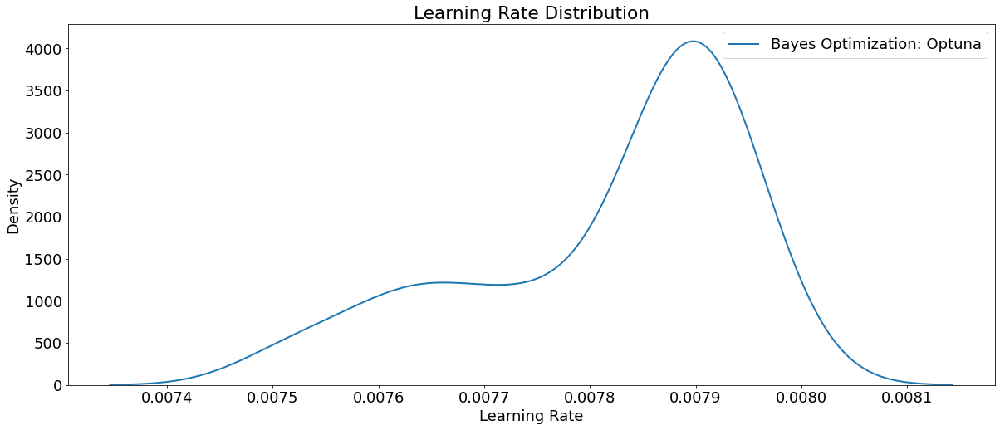

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

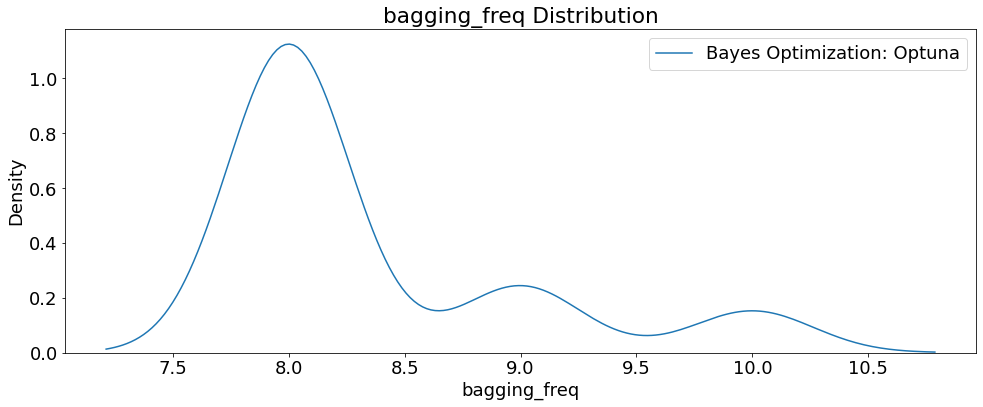

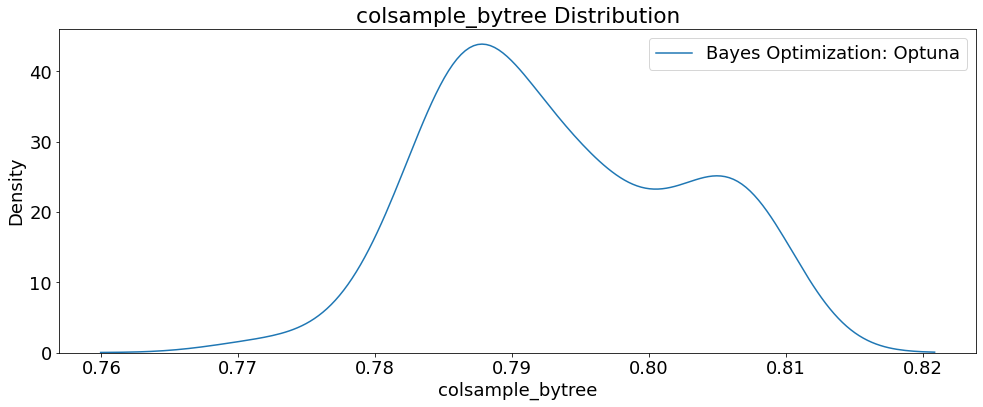

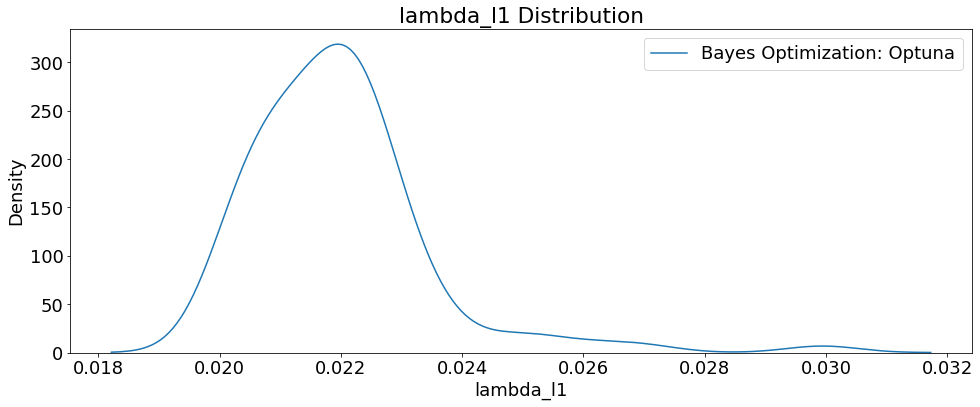

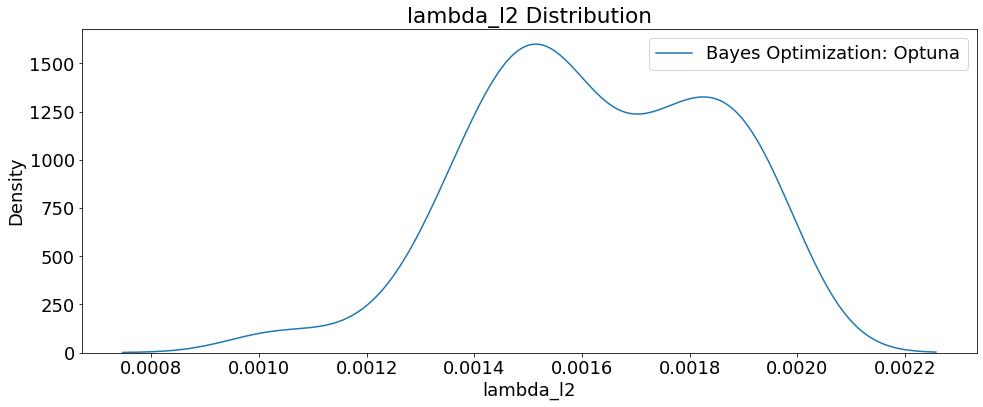

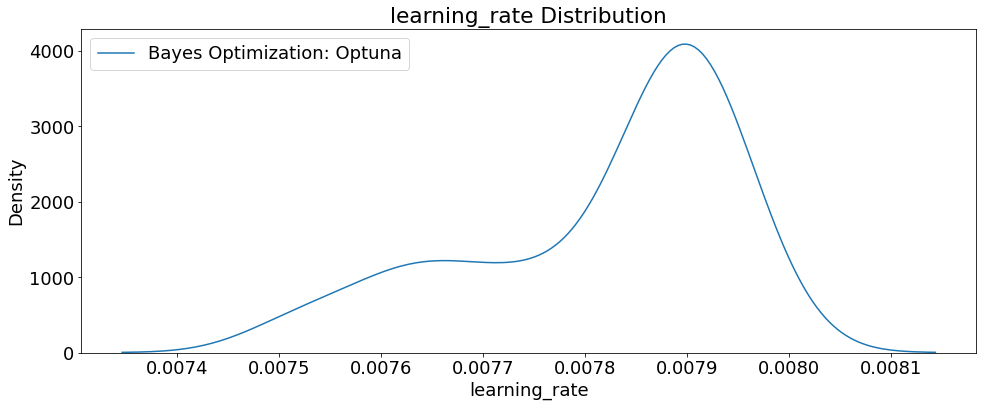

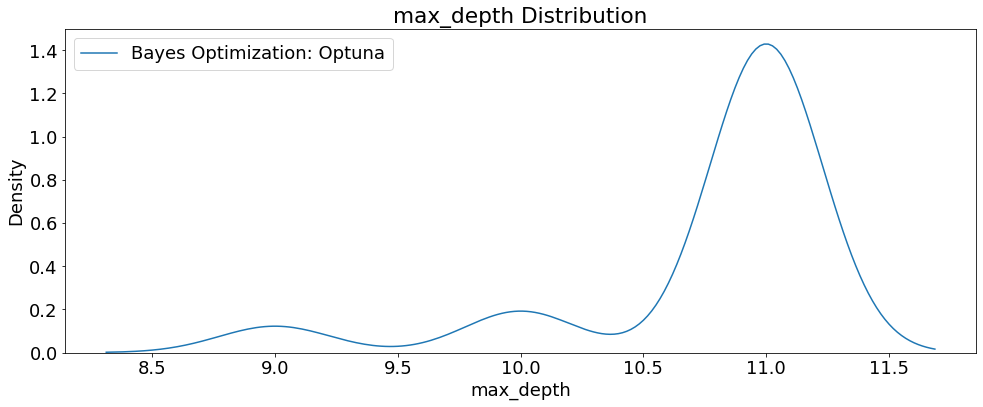

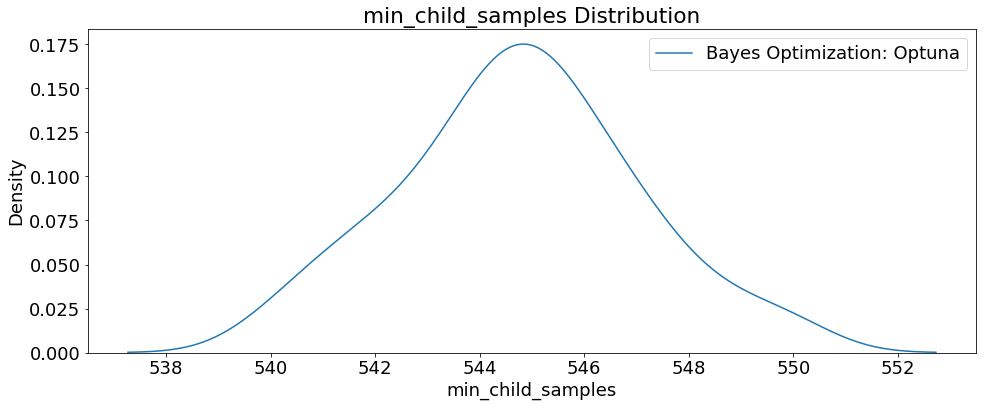

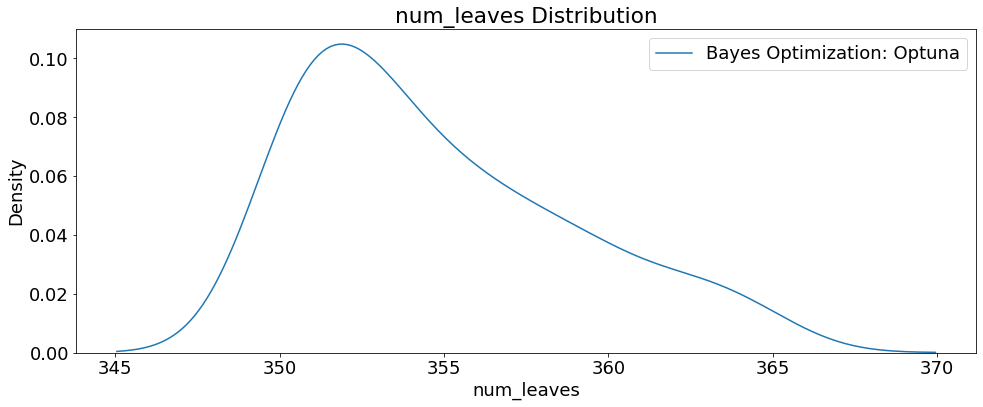

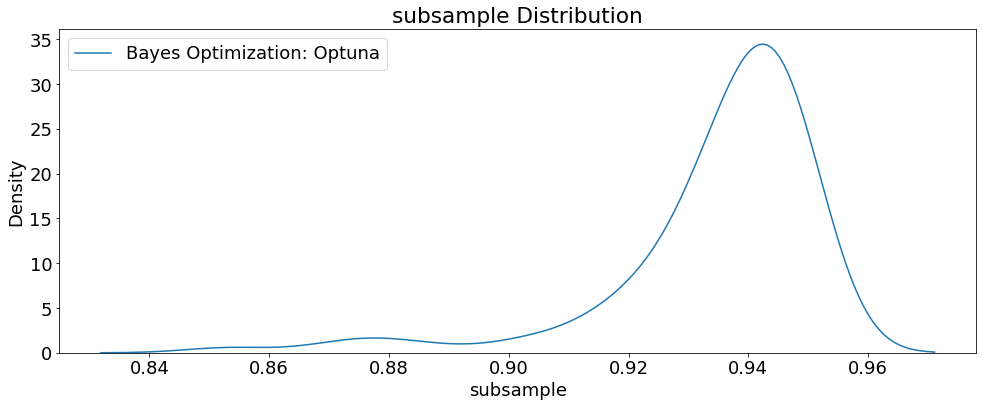

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

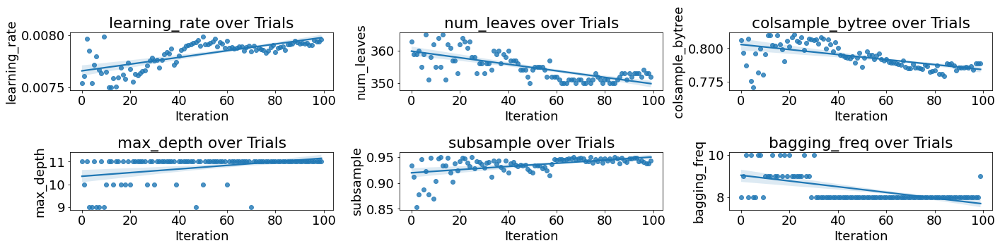

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

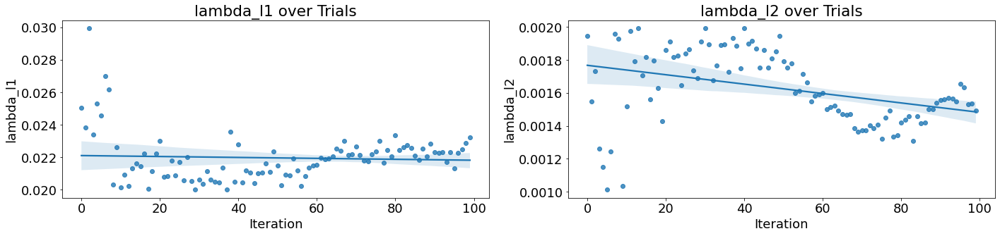

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_RTX5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 926,
 'learning_rate': 0.007936805701589712,
 'num_leaves': 353,
 'bagging_freq': 8,
 'subsample': 0.9377605888796087,
 'colsample_bytree': 0.7886023782336202,
 'max_depth': 11,
 'lambda_l1': 0.022491964269589732,
 'lambda_l2': 0.001529123062791912,
 'min_child_samples': 543,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_RTX5000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_RTX5000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.203, test: 1967.747
MSE train: 6809210.458, test: 6955760.671
RMSE train: 2609.446, test: 2637.378
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6955760.67113 MSE on the test set.
This was achieved using these conditions:
iteration                                    97
rmse                                2635.708452
datetime_start       2023-01-26 03:46:55.132044
datetime_complete    2023-01-26 03:47:30.556256
duration                 0 days 00:00:35.424212
bagging_freq                                  8
colsample_bytree                       0.788602
lambda_l1                              0.022492
lambda_l2                              0.001529
learning_rate                          0.007937
max_depth                                    11
min_child_samples                           543
n_estimators                                926
num_leaves                                  353
subsample                              0.937761
state                                  COMPLETE
Name: 97, dtype: object


# RTX A4000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi
os.environ['CUDA_VISIBLE_DEVICES'] = '0'



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Thu Jan 19 20:00:43 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   38C    P8    14W / 140W |      2MiB / 16376MiB |      0%      Default |
|                               |    

### 100 Trials Train/Test

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_A4000_trainTest_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_A4000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate',
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002, 
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(**params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-26 18:47:28.101013


Trial RMSE: 2684.6013698288452


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2678.1790163266382


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2671.7758271002835


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2711.95860697


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2676.2401105114263


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2647.8822377909905


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2675.595195783132


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2678.8733035251157


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2712.5251296492916


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2709.7279989041263


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.2821666802142


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.2701631218983


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.9271981049387


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.5900514949008


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.521794477323


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.41672978437


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.5477528084944


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.2651914447074


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.100484061646


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.616054801348


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.577566348954


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.8048160602675


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.94568478173


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.39132371123


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.592564301784


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.5842090785673


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.329001795932


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2658.9202896535808


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.9694199148908


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2667.915721204129


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.355921888108


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.354757824055


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.449058096096


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.7226003702317


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.769274819188


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.2300815492376


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.7994313134323


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.66704670224


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.0617159097446


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.2575778436794


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2699.1210053733253


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.3689505904717


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.836152771515


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.9612657758676


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.2955934697825


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.823875529043


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.9833504394005


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.1616887937134


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.340117785452


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.4682528718927


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.64181366111


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.5799920503223


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.0300612501646


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.235673220475


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.815587803669


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2698.3181415969457


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2639.141403612324


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.2410378923746


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.059079167409


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.62142312841


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.5656065489657


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.30483093042


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.039726003137


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.1180115492552


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.4859097209583


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.5067067196474


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.2408974967234


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.321080882663


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.535071768192


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.189492723112


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2660.834382825795


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.8363602218387


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.6729223567204


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.1271219957616


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.6580895769566


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.669036891137


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.8361844965357


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.429442970803


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.3079246142483


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.10647056555


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.961984287982


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.3146285225093


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.7664136762446


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.2542784816787


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.1071481015647


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.8205130516394


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.0353912383703


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.2234306176692


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.6071239906464


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.283221468334


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.110015283857


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.486331208766


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.1829485250514


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.6518477237237


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.5672100233587


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.968460486063


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.6086755571787


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.9865031809586


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.7630800219586


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.8679443078295


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-26 18:47:28.101013
End Time             2023-01-26 20:58:57.559003
2:11:29


Number of finished trials: 100
Best trial: {'n_estimators': 934, 'learning_rate': 0.00798879300097316, 'num_leaves': 359, 'bagging_freq': 10, 'subsample': 0.9376244855806946, 'colsample_bytree': 0.774982767376917, 'max_depth': 11, 'lambda_l1': 0.02882206628062635, 'lambda_l2': 0.0016511070127227818, 'min_child_samples': 542}
Lowest RMSE 2632.6071239906464


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
88         88  2632.607124 2023-01-26 20:40:32.929015   
84         84  2633.107148 2023-01-26 20:34:35.390573   
92         92  2633.182949 2023-01-26 20:45:29.289499   
81         81  2633.314629 2023-01-26 20:28:34.228015   
91         91  2633.486331 2023-01-26 20:44:00.806791   
..        ...          ...                        ...   
55         55  2698.318142 2023-01-26 19:44:15.160439   
40         40  2699.121005 2023-01-26 19:24:39.887390   
9           9  2709.727999 2023-01-26 18:55:40.163492   
3           3  2711.958607 2023-01-26 18:50:08.091668   
8           8  2712.525130 2023-01-26 18:54:53.054782   

            datetime_complete               duration  bagging_freq  \
88 2023-01-26 20:41:11.736361 0 days 00:00:38.807346            10   
84 2023-01-26 20:35:25.547461 0 days 00:00:50.156888            10   
92 2023-01-26 20:46:25.914154 0 days 00:00:56.624655            10   
81 2023-01-26 20:29:23.842481 0 day

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.html')
fig.show()

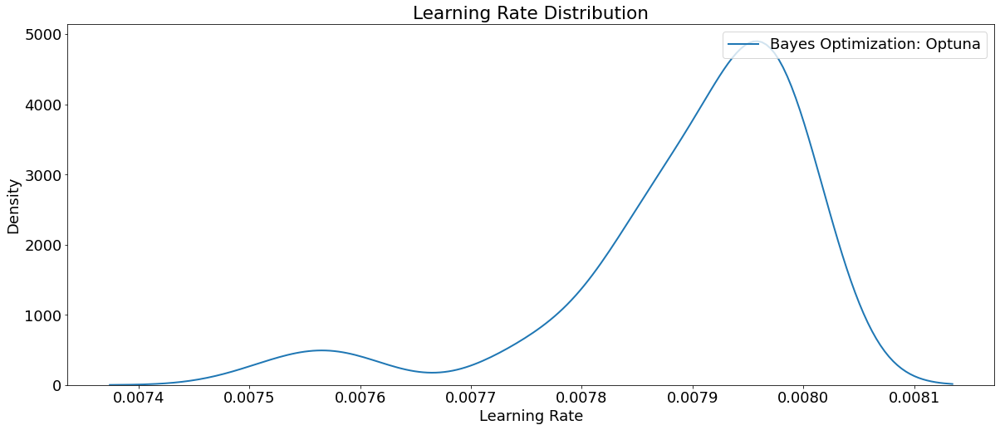

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

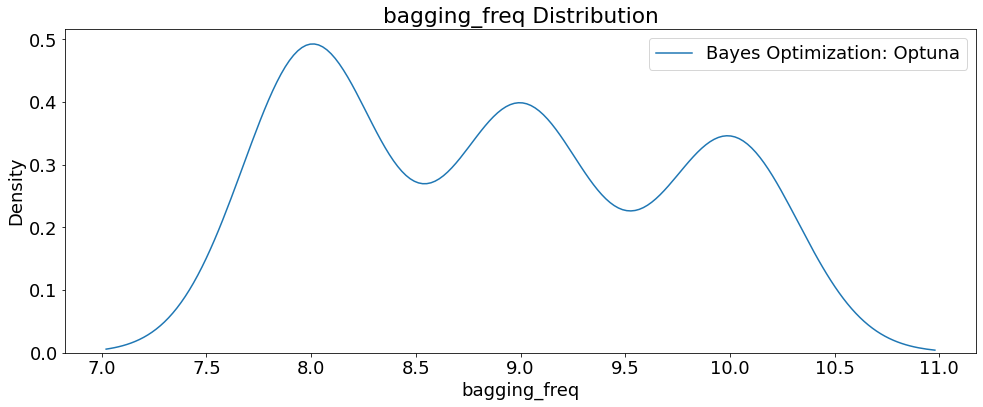

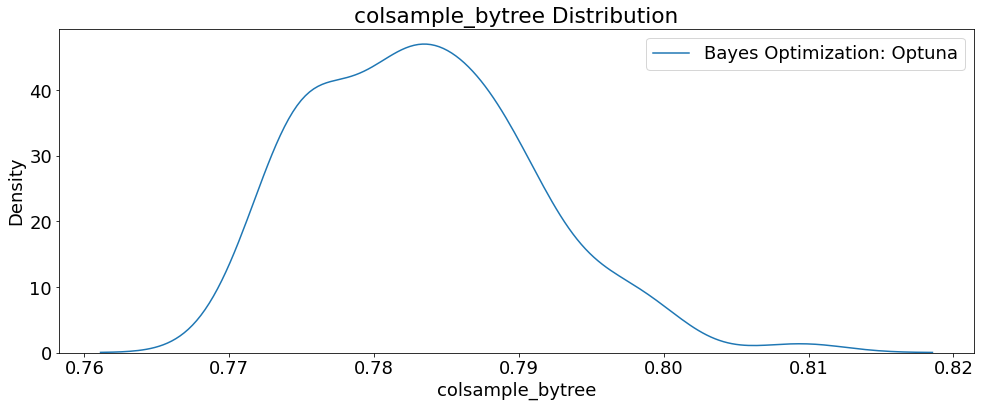

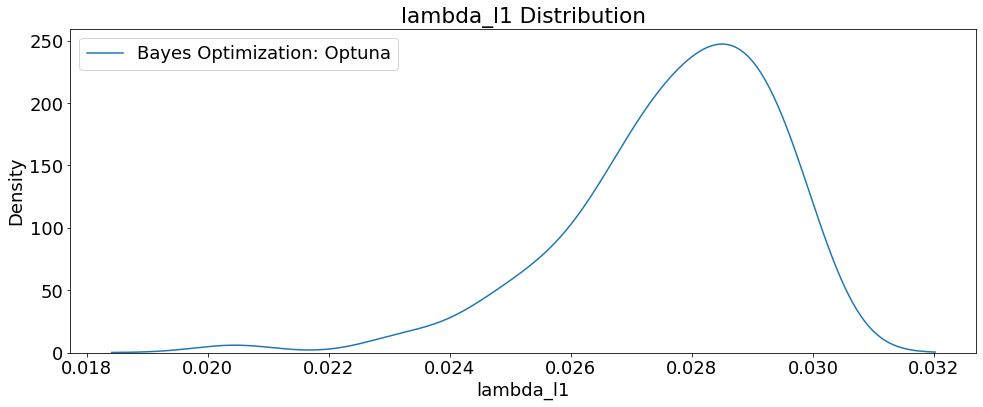

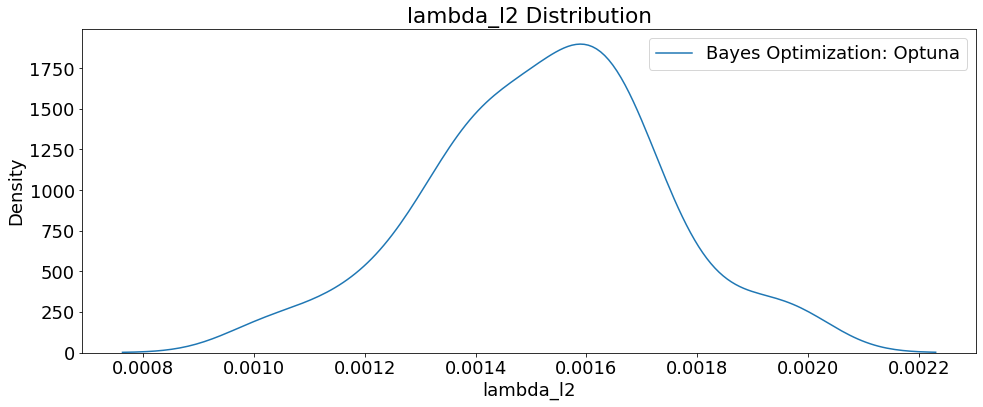

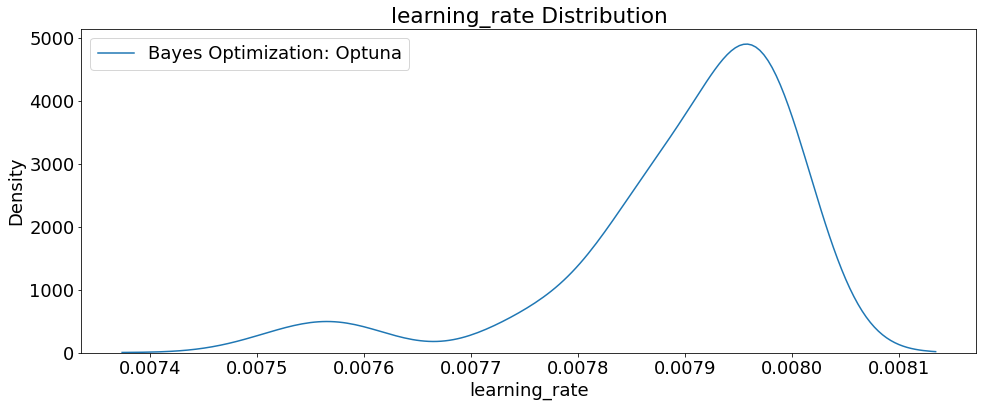

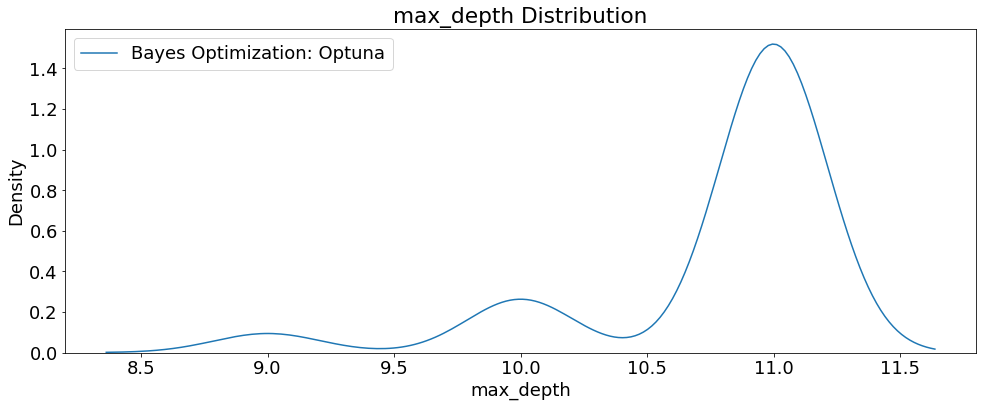

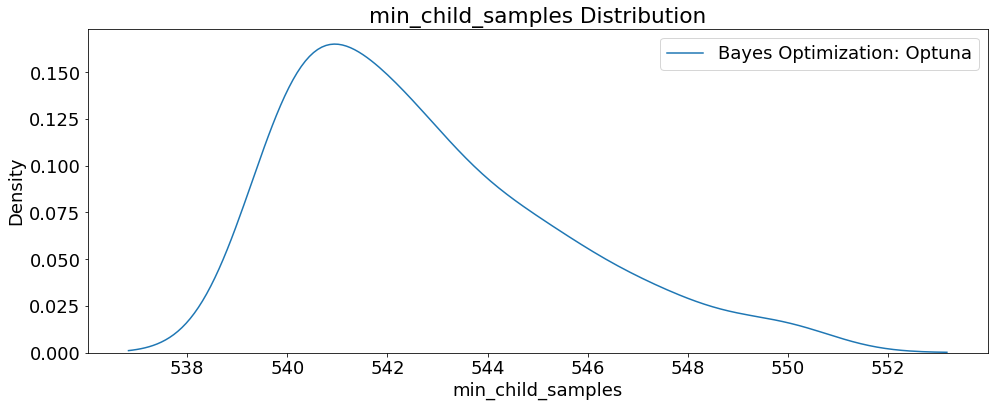

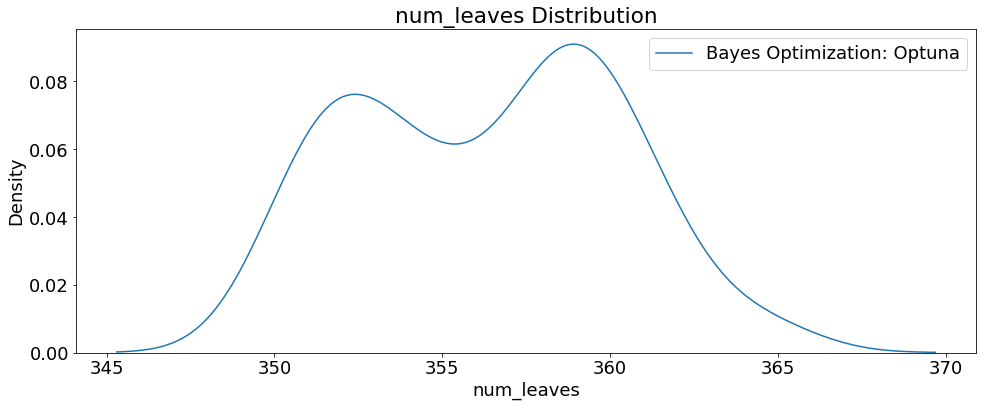

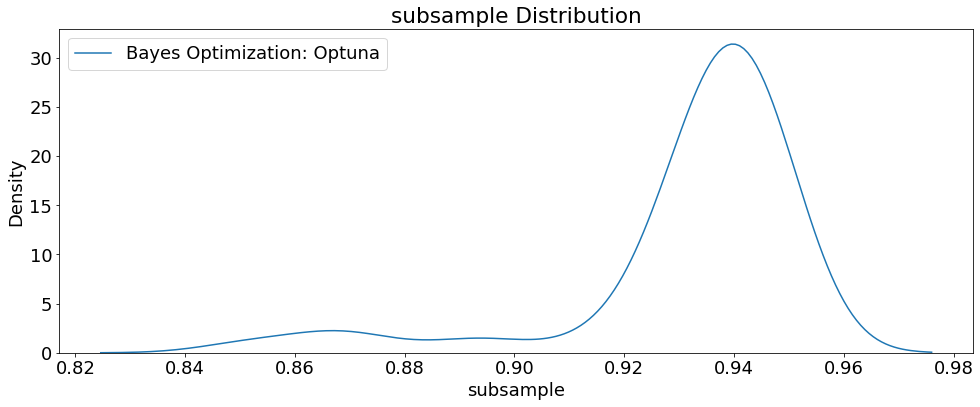

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

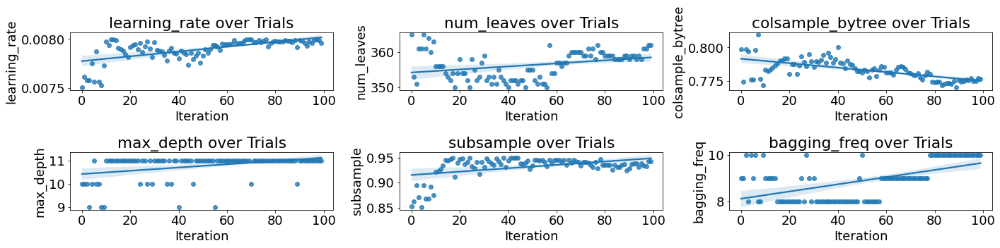

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

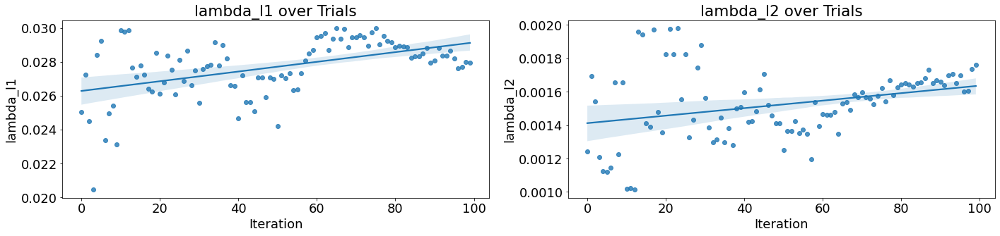

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_A4000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 934,
 'learning_rate': 0.00798879300097316,
 'num_leaves': 359,
 'bagging_freq': 10,
 'subsample': 0.9376244855806946,
 'colsample_bytree': 0.774982767376917,
 'max_depth': 11,
 'lambda_l1': 0.02882206628062635,
 'lambda_l2': 0.0016511070127227818,
 'min_child_samples': 542,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_A4000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_A4000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1942.538, test: 1964.546
MSE train: 6792014.691, test: 6935953.666
RMSE train: 2606.149, test: 2633.620
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6935953.66551 MSE on the test set.
This was achieved using these conditions:
iteration                                    88
rmse                                2632.607124
datetime_start       2023-01-26 20:40:32.929015
datetime_complete    2023-01-26 20:41:11.736361
duration                 0 days 00:00:38.807346
bagging_freq                                 10
colsample_bytree                       0.774983
lambda_l1                              0.028822
lambda_l2                              0.001651
learning_rate                          0.007989
max_depth                                    11
min_child_samples                           542
n_estimators                                934
num_leaves                                  359
subsample                              0.937624
state                                  COMPLETE
Name: 88, dtype: object


# Quadro P5000

In [ ]:
# Install/import dependencies
import os
import random
import warnings
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sat Jan 28 21:46:18 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro P5000        Off  | 00000000:00:05.0 Off |                  Off |
| 26%   25C    P8     6W / 180W |      2MiB / 16384MiB |      0%      Default |
|                               |    

### 100 Trials Train/Test

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_P5000_trainTest_cuml', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_P5000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002, 
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Define model
    model = LGBMRegressor(**params)
    
    # Start timer for each trial
    start = timer()
      
     # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)])
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-26 13:51:52.481952


Trial RMSE: 2673.835159802648


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.1685289269694


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2654.429713471408


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2649.6811521523987


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2709.9726706011556


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2713.2409193053113


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2672.407779287006


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2672.9252007762816


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.8961319967993


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2643.243826486799


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2640.428673464545


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.185950615729


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.123771265242


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2663.5118336559754


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.7235042435495


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2661.8115611911917


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.4696089624294


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2702.929959039072


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2666.4402840518615


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.1559978034766


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2662.206004980363


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.335043939131


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.208412527981


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.961462470691


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.464957795992


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.9822841576247


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.788523609621


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2666.231285075359


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.1390703265456


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2641.402469166347


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2661.9649207522043


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.315868463863


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.5993378318053


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.847920006804


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.098253204692


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.659547779256


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.859778903689


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.084427254452


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2659.2812293363518


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.175665986504


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2700.2264286379573


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.8316014916477


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.290671649255


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.982980414961


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.2648682445197


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.638915351786


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.997712896262


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.011184470138


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.744677352151


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.644920408175


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.914866271739


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.825905647003


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.914261095239


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.9808034923444


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.120489548232


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.3004852982963


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2700.9191562053584


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.5885006060034


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2658.34641930792


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.461231550861


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.7691621655385


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.241892875216


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.774383629054


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.6501893721766


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.1826862558037


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.1152044287855


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.409237161173


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2638.425634877969


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.1700174891407


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2636.894821302847


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2660.7254514919173


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.6781520953527


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.1417173128816


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.840288409241


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Problem at: /usr/local/lib/python3.9/dist-packages/optuna/integration/wandb.py 236 _initialize_run


Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 1108, in init
    run = wi.init()
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 742, in init
    raise error
wandb.errors.CommError: Error communicating with wandb process, exiting...
For more info see: https://docs.wandb.ai/library/init#init-start-error
wandb: ERROR Abnormal program exit
[W 2023-01-26 15:33:22,821] Trial 74 failed with parameters: {} because of the following error: Exception('problem').
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 1108, in init
    run = wi.init()
  File "/usr/local/lib/python3.9/dist-packages/wandb/sdk/wandb_init.py", line 742, in init
    raise error
wandb.errors.CommError: Error communicating with wandb process, exiting...
For more info see: https://docs.wandb.ai/library/init#init-start-error

The above exception was the direct cause of th

Exception: problem

In [ ]:
# Load to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 74
Best trial: {'n_estimators': 932, 'learning_rate': 0.007996249042938556, 'num_leaves': 364, 'bagging_freq': 10, 'subsample': 0.9438852300428189, 'colsample_bytree': 0.7970203060074771, 'max_depth': 11, 'lambda_l1': 0.02698035213570389, 'lambda_l2': 0.0014053791094403333, 'min_child_samples': 545}
Lowest RMSE 2633.098253204692


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=26, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-26 16:58:58.149911


Trial RMSE: 2634.8651576478487


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2635.6965756855184


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.9135874539143


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2637.450076756817


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.6020606531433


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.3064775156545


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.483220507881


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.745163453912


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.695083688246


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.802277401422


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.9907021964164


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.5534209136194


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.1852416480906


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.9535137686685


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.8150158848043


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.148599791304


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.3583866174286


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2632.724564798926


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.439573922892


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.186836661628


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.398224726194


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.007892923195


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.3097872355474


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2631.8662641505884


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2634.411831095181


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Trial RMSE: 2633.162198201096


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-26 16:58:58.149911
End Time             2023-01-26 17:28:05.804622
0:29:07


Number of finished trials: 100
Best trial: {'n_estimators': 935, 'learning_rate': 0.007978510977680153, 'num_leaves': 358, 'bagging_freq': 10, 'subsample': 0.9435114993988676, 'colsample_bytree': 0.7885611027218716, 'max_depth': 11, 'lambda_l1': 0.02742137527836653, 'lambda_l2': 0.001393750950454301, 'min_child_samples': 541}
Lowest RMSE 2631.148599791304


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
89         89  2631.148600 2023-01-26 17:16:06.123465   
86         86  2631.185242 2023-01-26 17:13:28.283840   
96         96  2631.309787 2023-01-26 17:23:50.376009   
85         85  2631.553421 2023-01-26 17:12:19.213934   
81         81  2631.745163 2023-01-26 17:07:10.092987   
..        ...          ...                        ...   
56         56  2700.919156 2023-01-26 14:44:07.439681   
17         17  2702.929959 2023-01-26 14:05:27.094699   
4           4  2709.972671 2023-01-26 13:55:06.408139   
5           5  2713.240919 2023-01-26 13:55:45.553059   
73         73          NaN 2023-01-26 14:58:33.120431   

            datetime_complete               duration  bagging_freq  \
89 2023-01-26 17:16:43.519572 0 days 00:00:37.396107          10.0   
86 2023-01-26 17:14:13.927310 0 days 00:00:45.643470          10.0   
96 2023-01-26 17:24:41.335128 0 days 00:00:50.959119          10.0   
85 2023-01-26 17:13:00.187797 0 day

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.html')
fig.show()

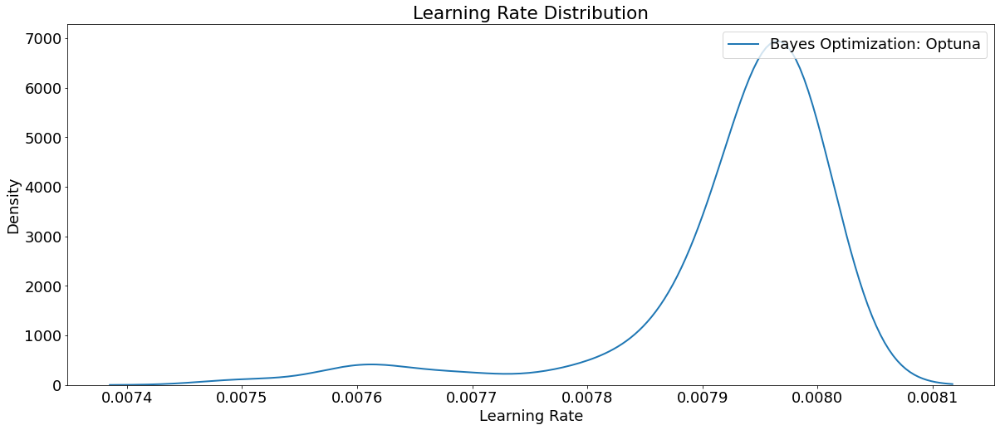

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

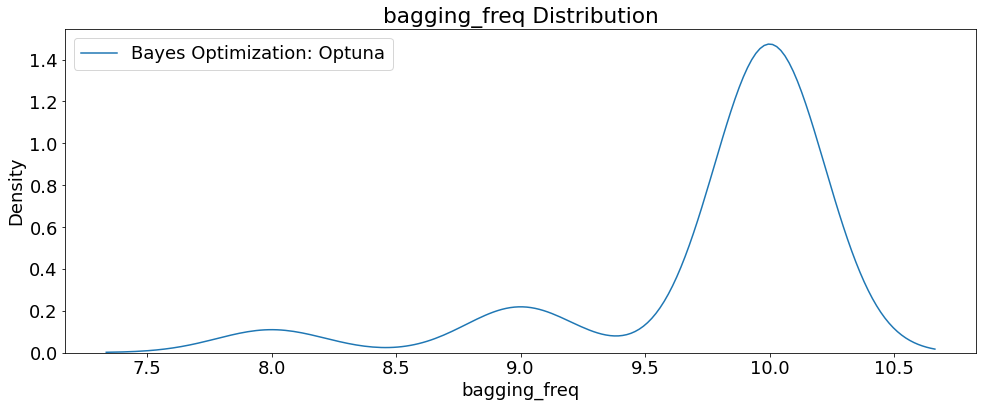

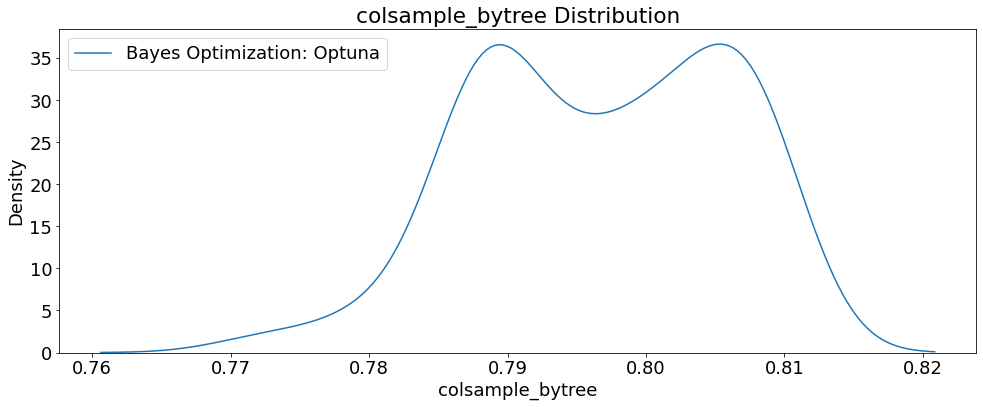

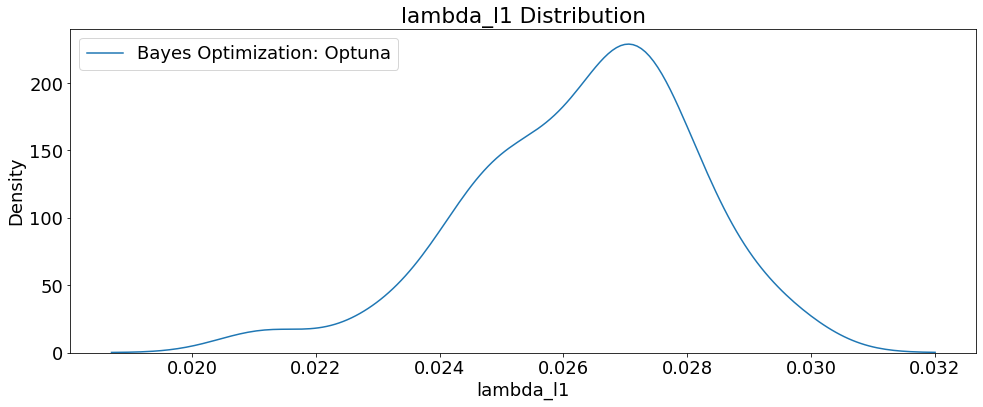

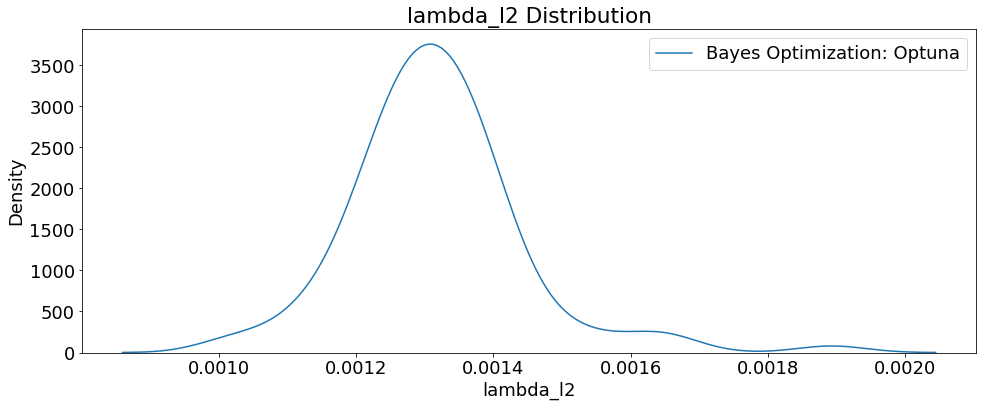

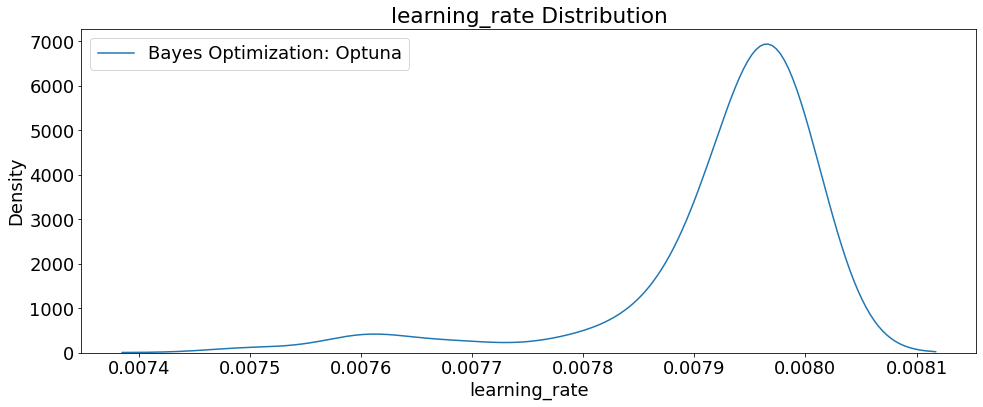

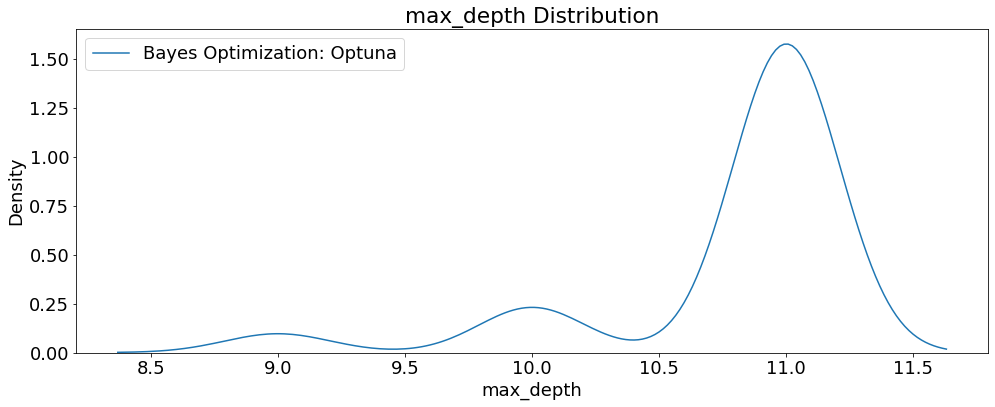

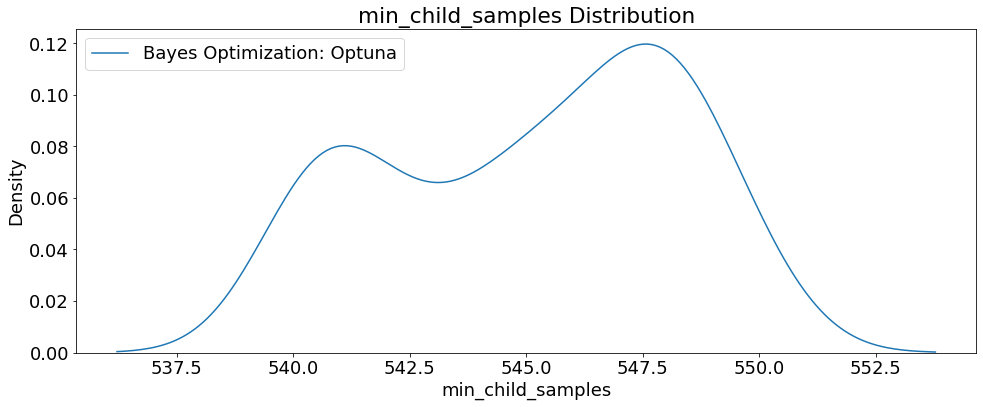

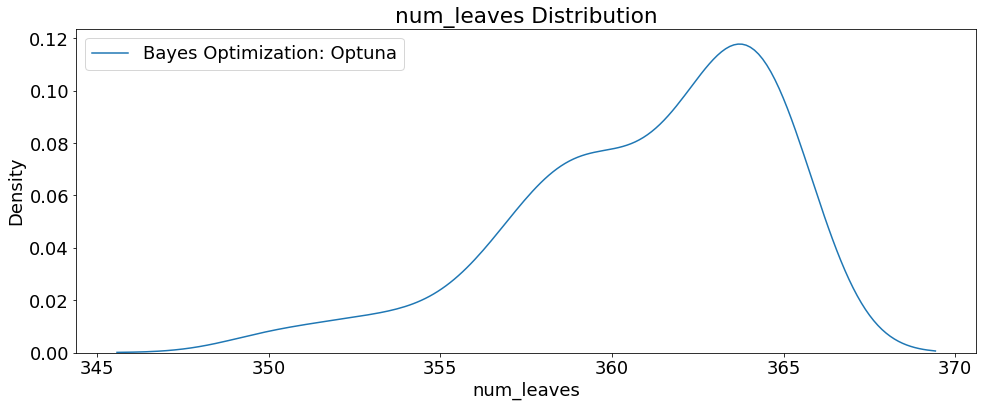

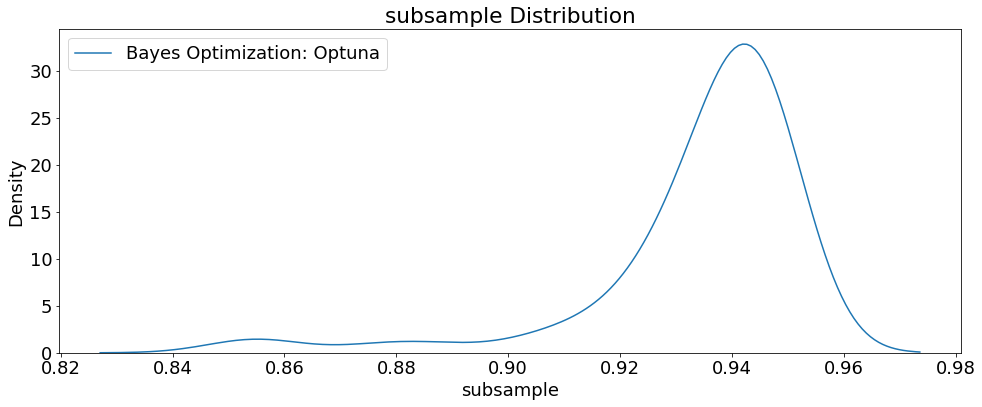

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

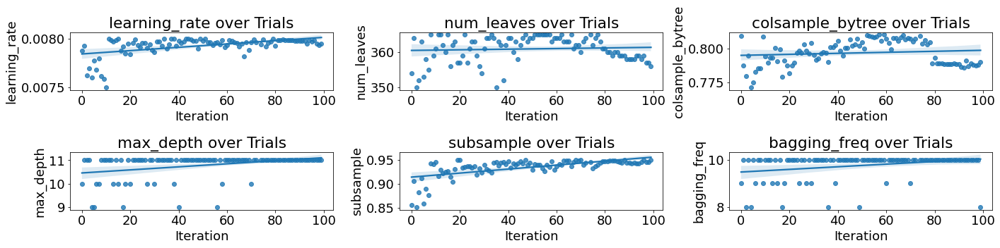

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

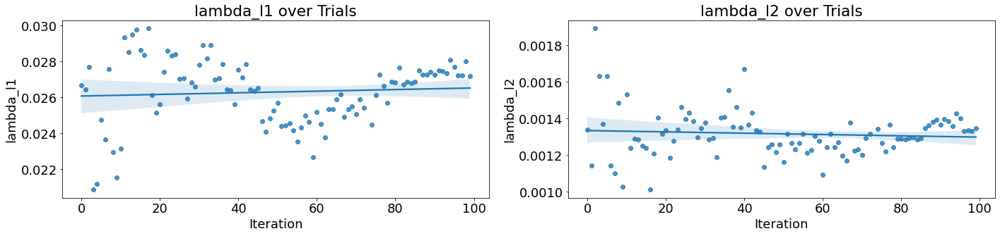

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_P5000_wb_trainTest_cuml.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 935,
 'learning_rate': 0.007978510977680153,
 'num_leaves': 358,
 'bagging_freq': 10,
 'subsample': 0.9435114993988676,
 'colsample_bytree': 0.7885611027218716,
 'max_depth': 11,
 'lambda_l1': 0.02742137527836653,
 'lambda_l2': 0.001393750950454301,
 'min_child_samples': 541,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_P5000_wb_trainTest_cuml.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_P5000_wb_trainTest_cuml.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1942.774, test: 1964.960
MSE train: 6792235.761, test: 6936890.553
RMSE train: 2606.192, test: 2633.798
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6936890.55316 MSE on the test set.
This was achieved using these conditions:
iteration                                    89
rmse                                  2631.1486
datetime_start       2023-01-26 17:16:06.123465
datetime_complete    2023-01-26 17:16:43.519572
duration                 0 days 00:00:37.396107
bagging_freq                               10.0
colsample_bytree                       0.788561
lambda_l1                              0.027421
lambda_l2                              0.001394
learning_rate                          0.007979
max_depth                                  11.0
min_child_samples                         541.0
n_estimators                              935.0
num_leaves                                358.0
subsample                              0.943511
state                                  COMPLETE
Name: 89, dtype: object
